<a href="https://colab.research.google.com/github/Dillonreed/3831-Coursework-Part-3/blob/main/3831_Coursework_Part_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 3831 Coursework Part 3

## Imports

In [10]:
import cv2
from google.colab.patches import cv2_imshow
import imageio.v2 as iio

import numpy as np
import matplotlib.pyplot as plt

from skimage.color import rgb2gray

from skimage.restoration import denoise_tv_chambolle, denoise_wavelet
from scipy.ndimage import gaussian_filter, correlate, median_filter

from skimage.metrics import structural_similarity

## My Denoising Algorithm

In [11]:
# Documentation on performing Fourier transform from https://towardsdatascience.com/image-processing-with-python-application-of-fourier-transformation-5a8584dc175b
# Documentation on performing Total Variant Filter from https://scikit-image.org/docs/stable/auto_examples/filters/plot_denoise.html
# Documentation on performing Gaussian Filter from https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.gaussian_filter.html

# Defining function for my denoising algorithm
def myDenoisingAlgorithm(greyNoisyImage10, greyNoisyImage25, greyNoisyImage50):
    # Create Fourier transform from sample image
    fourierCleanImage10 = np.fft.fftshift(np.fft.fft2(greyNoisyImage10))
    fourierCleanImage25 = np.fft.fftshift(np.fft.fft2(greyNoisyImage25))
    fourierCleanImage50 = np.fft.fftshift(np.fft.fft2(greyNoisyImage50))

    # Apply Fourier inverse transform to new image
    fourierCleanImage10 = abs(np.fft.ifft2(fourierCleanImage10))
    fourierCleanImage25 = abs(np.fft.ifft2(fourierCleanImage25))
    fourierCleanImage50 = abs(np.fft.ifft2(fourierCleanImage50))

    # Apply the Total Variant Filter to the new image
    totalVariantFilterCleanImage10 = denoise_tv_chambolle(fourierCleanImage10, weight=0.2, channel_axis=-1)
    totalVariantFilterCleanImage25 = denoise_tv_chambolle(fourierCleanImage25, weight=0.4, channel_axis=-1)
    totalVariantFilterCleanImage50 = denoise_tv_chambolle(fourierCleanImage50, weight=0.4, channel_axis=-1)

    # Apply Gaussian filter to the new image
    gaussianFilterCleanImage10 = gaussian_filter(totalVariantFilterCleanImage10, sigma=1)
    gaussianFilterCleanImage25 = gaussian_filter(totalVariantFilterCleanImage25, sigma=1)
    gaussianFilterCleanImage50 = gaussian_filter(totalVariantFilterCleanImage50, sigma=3)

    return (gaussianFilterCleanImage10, gaussianFilterCleanImage25, gaussianFilterCleanImage50)

## Creating Functions for Other Prominent Denoising Methods

### Mean Filter

In [12]:
# Documentation for performing Mean Filter from https://scikit-image.org/skimage-tutorials/lectures/1_image_filters.html

# Defining function for performing mean filter denoising
def meanDenoisingAlgorithm(greyNoisyImage10, greyNoisyImage25, greyNoisyImage50):
    meanCleanImage10 = correlate(greyNoisyImage10, np.full((5, 5), 1/25))
    meanCleanImage25 = correlate(greyNoisyImage25, np.full((6, 6), 1/36))
    meanCleanImage50 = correlate(greyNoisyImage50, np.full((7, 7), 1/49))

    return meanCleanImage10, meanCleanImage25, meanCleanImage50

### Median Filter

In [13]:
# Documentation for performing Median Filter from https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.median_filter.html

# Defining function for performing median filter denoising
def medianDenoisingAlgorithm(greyNoisyImage10, greyNoisyImage25, greyNoisyImage50):
    medianCleanImage10 = median_filter(greyNoisyImage10, size=7)
    medianCleanImage25 = median_filter(greyNoisyImage25, size=10)
    medianCleanImage50 = median_filter(greyNoisyImage50, size=15)

    return medianCleanImage10, medianCleanImage25, medianCleanImage50

### Wavelet Denoising

In [14]:
# Documentation for performing Wavelet denoising from https://scikit-image.org/docs/stable/auto_examples/filters/plot_denoise_wavelet.html

# Defining function for performing wavelet denoising (BayesShrink)
def waveletDenoisingAlgorithm(noisyImage10, noisyImage25, noisyImage50):

    # Since wavelet needs to be done in colour and the rest is done in greyscale, will convert image after
    waveletCleanImage10 = cv2.cvtColor(cv2.cvtColor(denoise_wavelet(noisyImage10, channel_axis=-1, convert2ycbcr=True,
                            method='BayesShrink', mode='soft',
                            rescale_sigma=True), cv2.COLOR_YCrCb2RGB), cv2.COLOR_RGB2GRAY)

    waveletCleanImage25 = cv2.cvtColor(cv2.cvtColor(denoise_wavelet(noisyImage25, channel_axis=-1, convert2ycbcr=True,
                            method='BayesShrink', mode='soft',
                            rescale_sigma=True), cv2.COLOR_YCrCb2RGB), cv2.COLOR_RGB2GRAY)

    waveletCleanImage50 = cv2.cvtColor(cv2.cvtColor(denoise_wavelet(noisyImage50, channel_axis=-1, convert2ycbcr=True,
                            method='BayesShrink', mode='soft',
                            rescale_sigma=True), cv2.COLOR_YCrCb2RGB), cv2.COLOR_RGB2GRAY)

    return waveletCleanImage10, waveletCleanImage25, waveletCleanImage50

## Comparing Original and Denoised Images

### Function for Calculating MSE

In [15]:
# Utilised code for calculating MSE from https://www.tutorialspoint.com/how-to-compare-two-images-in-opencv-python

# Define function for calculating MSE for two given images
def calculateMSE(cleanImage1, cleanImage2):
   height, width = cleanImage1.shape
   difference = cv2.subtract(cleanImage1, cleanImage2)

   error = np.sum(difference ** 2)

   mse = error / float(height * width)

   return mse

### Function for Creating Comparison Grid

In [16]:
# Define function for generating the 2x3 grid for denoised images produced by
# each of the denoising methods
def createDenoisingAlgorithmsGrid(myCleanImage, meanCleanImage, medianCleanImage, waveletCleanImage, originalImage, pathToSave):
    # Convert images to float values
    myCleanImage = np.asarray(myCleanImage, np.float64)
    meanCleanImage = np.asarray(meanCleanImage, np.float64)
    medianCleanImage = np.asarray(medianCleanImage, np.float64)
    waveletCleanImage = np.asarray(waveletCleanImage, np.float64)

    originalImage = np.asarray(originalImage, np.float64)

    # Calculate MSE/SSIM scores for each image/denoising method
    errorMyAlgorithmMSE = calculateMSE(originalImage, myCleanImage)
    errorMyAlgorithmSSIM, difference = structural_similarity(originalImage, myCleanImage, full=True)

    errorMeanMSE = calculateMSE(originalImage, meanCleanImage)
    errorMeanSSIM, difference = structural_similarity(originalImage, meanCleanImage, full=True)

    errorMedianMSE = calculateMSE(originalImage, medianCleanImage)
    errorMedianSSIM, difference = structural_similarity(originalImage, medianCleanImage, full=True)

    errorWaveletMSE = calculateMSE(originalImage, waveletCleanImage)
    errorWaveletSSIM, difference = structural_similarity(originalImage, waveletCleanImage, full=True)

    # Generate 2x3 grid where
    # (1, 1) = Noisy image inputted into denoising algorithms
    # (2, 1) = Blank subplot simply for layout purposes
    # (1, 2) = Cleaned image and analysis metrics for my denoising algorithm
    # (2, 2) = Cleaned image and analysis metrics for the mean filter denoising algorithm
    # (1, 3) = Cleaned image and analysis metrics for the median filter denoising algorithm
    # (2, 3) = Cleaned image and analysis metrics for the wavelet denoising algorithm
    comparisonGrid = plt.figure(figsize=(20, 20), dpi=100)

    # (1, 1)
    comparisonGrid.add_subplot(321)
    plt.imshow(originalImage)
    plt.title("Noisy Image to Denoise")

    # (1, 2)
    comparisonGrid.add_subplot(323)
    plt.imshow(myCleanImage)
    plt.title(f"My Denoising Algorithm \n MSE : {errorMyAlgorithmMSE} and SSIM : {errorMyAlgorithmSSIM}")
    plt.axis("off")

    # (2, 2)
    comparisonGrid.add_subplot(324)
    plt.imshow(meanCleanImage)
    plt.title(f"Mean Filter Denoising Algorithm \n MSE : {errorMeanMSE} and SSIM : {errorMeanSSIM}")
    plt.axis("off")

    # (1, 3)
    comparisonGrid.add_subplot(325)
    plt.imshow(medianCleanImage)
    plt.title(f"Median Filter Denoising Algorithm \n MSE : {errorMedianMSE} and SSIM : {errorMedianSSIM}")
    plt.axis("off")

    # (2, 3)
    comparisonGrid.add_subplot(326)
    plt.imshow(waveletCleanImage)
    plt.title(f"Wavelet (BayesShrink) Denoising Algorithm \n MSE : {errorWaveletMSE} and SSIM : {errorWaveletSSIM}")
    plt.axis("off")

    # Close intermediate figures created by matplotlib
    plt.close()

    # Save record for future use
    comparisonGrid.savefig(pathToSave)

### Function for Creating Comparison Record

In [17]:
# Define function for generating 1x4 comparison record for each original image
# and its respective noisy images
def createComparisonRecord(imageNumber):
    # Obtain image number from input - may need to add preceding 0
    if imageNumber < 10:
        image = f"0{str(imageNumber)}"
    else:
        image = str(imageNumber)

    # Read in the original image and its respective noisy images
    noisyImage10 = iio.imread(f"https://raw.githubusercontent.com/Dillonreed/3831-Coursework-Part-3/main/Images/noisy10/00{image}" + ".png")
    noisyImage25 = iio.imread(f"https://raw.githubusercontent.com/Dillonreed/3831-Coursework-Part-3/main/Images/noisy25/00{image}" + ".png")
    noisyImage50 = iio.imread(f"https://raw.githubusercontent.com/Dillonreed/3831-Coursework-Part-3/main/Images/noisy50/00{image}" + ".png")
    originalImage = iio.imread(f"https://raw.githubusercontent.com/Dillonreed/3831-Coursework-Part-3/main/Images/original/00{image}" + ".png")

    # Convert noisy images to float
    noisyImage10 = np.float32(noisyImage10)
    noisyImage25 = np.float32(noisyImage25)
    noisyImage50 = np.float32(noisyImage50)

    # Convert float images to greyscale
    greyNoisyImage10 = cv2.cvtColor(noisyImage10, cv2.COLOR_BGR2GRAY)
    greyNoisyImage25 = cv2.cvtColor(noisyImage25, cv2.COLOR_BGR2GRAY)
    greyNoisyImage50 = cv2.cvtColor(noisyImage50, cv2.COLOR_BGR2GRAY)

    # Generate cleaned images from the denoising methods
    myCleanImage10, myCleanImage25, myCleanImage50 = myDenoisingAlgorithm(greyNoisyImage10, greyNoisyImage25, greyNoisyImage50)
    meanCleanImage10, meanCleanImage25, meanCleanImage50 = meanDenoisingAlgorithm(greyNoisyImage10, greyNoisyImage25, greyNoisyImage50)
    medianCleanImage10, medianCleanImage25, medianCleanImage50 = medianDenoisingAlgorithm(greyNoisyImage10, greyNoisyImage25, greyNoisyImage50)
    waveletCleanImage10, waveletCleanImage25, waveletCleanImage50 = waveletDenoisingAlgorithm(noisyImage10, noisyImage25, noisyImage50)

    # Generate 2x3 comparison grid for denoising methods for each noisy image
    createDenoisingAlgorithmsGrid(myCleanImage10, meanCleanImage10, medianCleanImage10, waveletCleanImage10, greyNoisyImage10, "10.png")
    createDenoisingAlgorithmsGrid(myCleanImage25, meanCleanImage25, medianCleanImage25,  waveletCleanImage25, greyNoisyImage25, "25.png")
    createDenoisingAlgorithmsGrid(myCleanImage50, meanCleanImage50, medianCleanImage50, waveletCleanImage50, greyNoisyImage50, "50.png")

    # Read in comparison grid for each noisy image
    comparisonGrid10 = iio.imread("10.png")
    comparisonGrid25 = iio.imread("25.png")
    comparisonGrid50 = iio.imread("50.png")

    # Generate 1x4 comparison record for the original image and its respective
    # noisy images
    # (1, 1) = Original Image
    # (1, 2) = Noisy10 comparison grid
    # (1, 3) = Noisy25 comparison grid
    # (1, 4) = Noisy50 comparison grid
    comparisonRecord = plt.figure(figsize = (40,10))

    # (1, 1)
    comparisonRecord.add_subplot(141)
    plt.imshow(originalImage)
    plt.title(f"Original Image Number : {imageNumber}")
    plt.axis("off")

    # (1, 2)
    comparisonRecord.add_subplot(142)
    plt.imshow(comparisonGrid10)
    plt.title("Noisy Image 10")
    plt.axis("off")

    # (1, 3)
    comparisonRecord.add_subplot(143)
    plt.imshow(comparisonGrid25)
    plt.title("Noisy Image 25")
    plt.axis("off")

    # (1, 4)
    comparisonRecord.add_subplot(144)
    plt.imshow(comparisonGrid50)
    plt.title("Noisy Image 50")
    plt.axis("off")

    # Save record for future use
    comparisonRecord.savefig(f"comparisonRecord.png")

    # Close intermediate figures created by matplotlib
    plt.close()

## Generating Results from Dataset

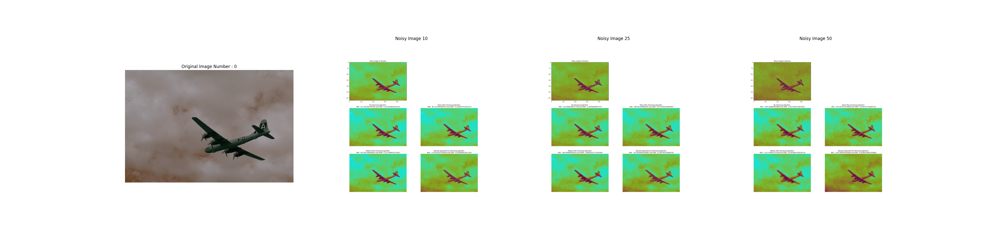

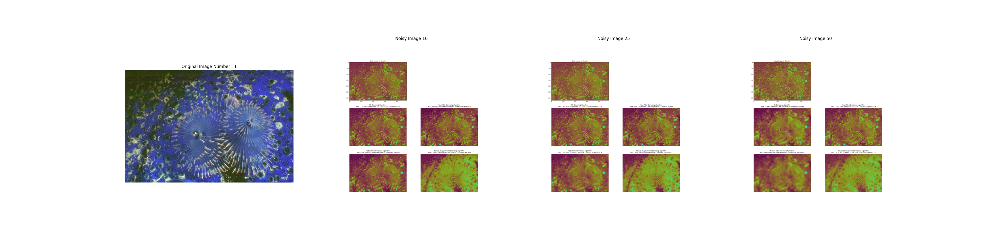

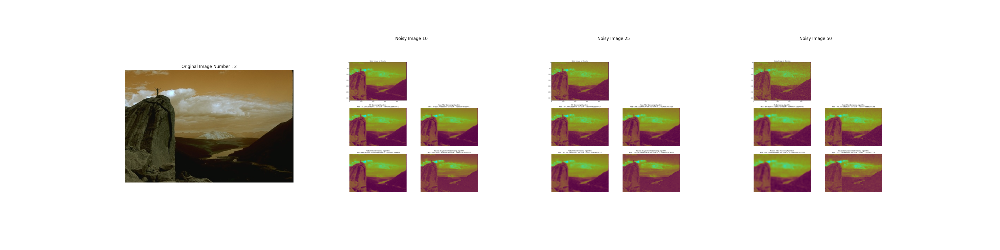

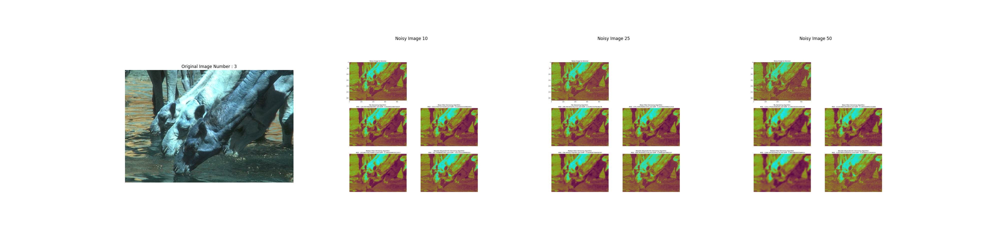

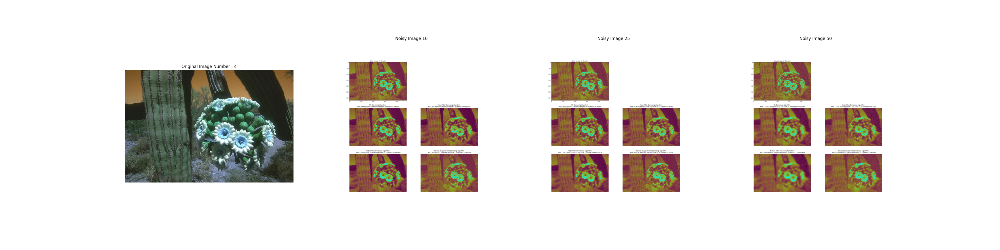

...

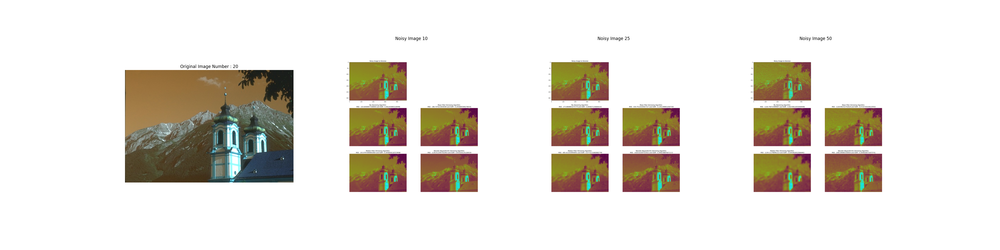

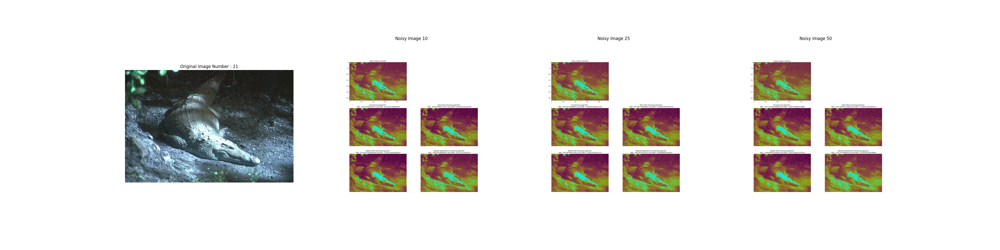

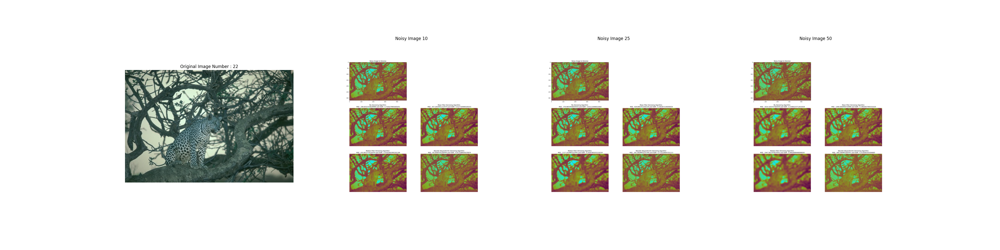

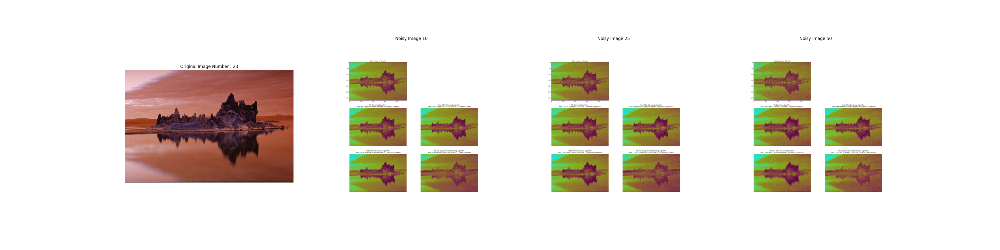

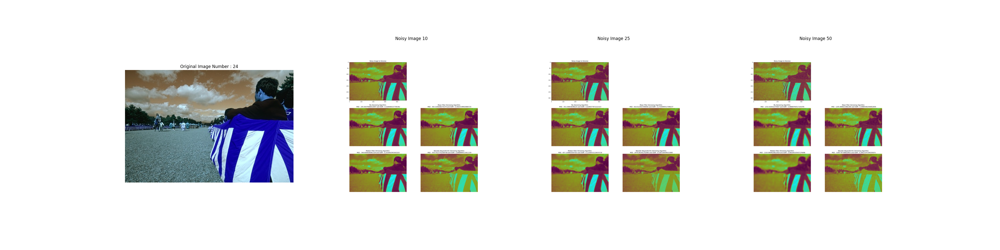

In [18]:
# @title Generate Denoising Results
generateOutputFile = True # @param {type:"boolean"}

# Define function for iterating through all images and outputing their
# comparison records, optionally create output file
def generateDenoisingResults():
    arrayOfImages = []

    # Create comparison records for each of the original images
    for imageNumber in range(0, 25):
        # Generate comparison record
        createComparisonRecord(imageNumber)

        # Add generated record to array
        comparisonRecordImage = iio.imread(f"comparisonRecord.png")
        arrayOfImages.append(comparisonRecordImage)

        # Show record in output of code
        #   Images shown in this way do have their colour skewed, to see colours
        #   accurately generate output file and investigate there
        cv2_imshow(comparisonRecordImage)

    if generateOutputFile == True:
        # Concatenating images together to form one large image (couldn't use
        # for loop or google colab kernel would crash due to exceeding
        # RAM usage))
        img1 = arrayOfImages[0]
        img1 = cv2.vconcat([img1, arrayOfImages[1]])
        img1 = cv2.vconcat([img1, arrayOfImages[2]])
        img1 = cv2.vconcat([img1, arrayOfImages[3]])
        img1 = cv2.vconcat([img1, arrayOfImages[4]])
        img1 = cv2.vconcat([img1, arrayOfImages[5]])
        img1 = cv2.vconcat([img1, arrayOfImages[6]])
        img1 = cv2.vconcat([img1, arrayOfImages[7]])
        img1 = cv2.vconcat([img1, arrayOfImages[8]])
        img1 = cv2.vconcat([img1, arrayOfImages[9]])
        img1 = cv2.vconcat([img1, arrayOfImages[10]])
        img1 = cv2.vconcat([img1, arrayOfImages[11]])
        img1 = cv2.vconcat([img1, arrayOfImages[12]])
        img1 = cv2.vconcat([img1, arrayOfImages[13]])
        img1 = cv2.vconcat([img1, arrayOfImages[14]])
        img1 = cv2.vconcat([img1, arrayOfImages[15]])
        img1 = cv2.vconcat([img1, arrayOfImages[16]])
        img1 = cv2.vconcat([img1, arrayOfImages[17]])
        img1 = cv2.vconcat([img1, arrayOfImages[18]])
        img1 = cv2.vconcat([img1, arrayOfImages[19]])
        img1 = cv2.vconcat([img1, arrayOfImages[20]])
        img1 = cv2.vconcat([img1, arrayOfImages[21]])
        img1 = cv2.vconcat([img1, arrayOfImages[22]])
        img1 = cv2.vconcat([img1, arrayOfImages[23]])
        img1 = cv2.vconcat([img1, arrayOfImages[24]])

        # Save concatenated records to a file
        iio.imwrite("DenoisingResults.png", img1)


generateDenoisingResults()